# Import the necessary libraries 

In [ ]:
import json
from pathlib import Path

import torch
from PIL import Image

from stellar_metrics import metric_names, run_metric

# We use mock test assets. You should adapt the paths to your own version of stellar-dataset and generated images.

* `syn_path` refers to the synthesized images
* `stellar_data_root` is the location of where the stellar-dataset is saved

In [2]:
syn_path = Path.cwd() / "tests" / "assets" / "stellar_net"
stellar_data_root = Path.cwd() / "tests" / "assets" / "mock_stellar_dataset"

In [3]:
# Use cuda if it is available.
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

# Run the metrics

We run IPS (`metric_names[0]` or we can supply `ips`)

In [4]:
df = run_metric(
    metric=metric_names[0],
    stellar_path=stellar_data_root,
    syn_path=syn_path,
    device=DEVICE,
    batch_size=2,
)

100%|███████████████████████████████████████████████████████| 6/6 [01:22<00:00, 13.81s/it]


In [5]:
df

,name,identity_preservation
0,000-0-00,0.274746
1,000-0-01,0.283943
2,000-0-02,0.266434
3,000-1-00,0.162208
4,000-1-01,0.507179
5,000-1-02,0.402828
6,199-0-00,0.344768
7,199-0-01,0.036013
8,199-0-02,0.402914
9,199-1-00,0.337469


# Manual Inspection of image `000-0-00`


## The input

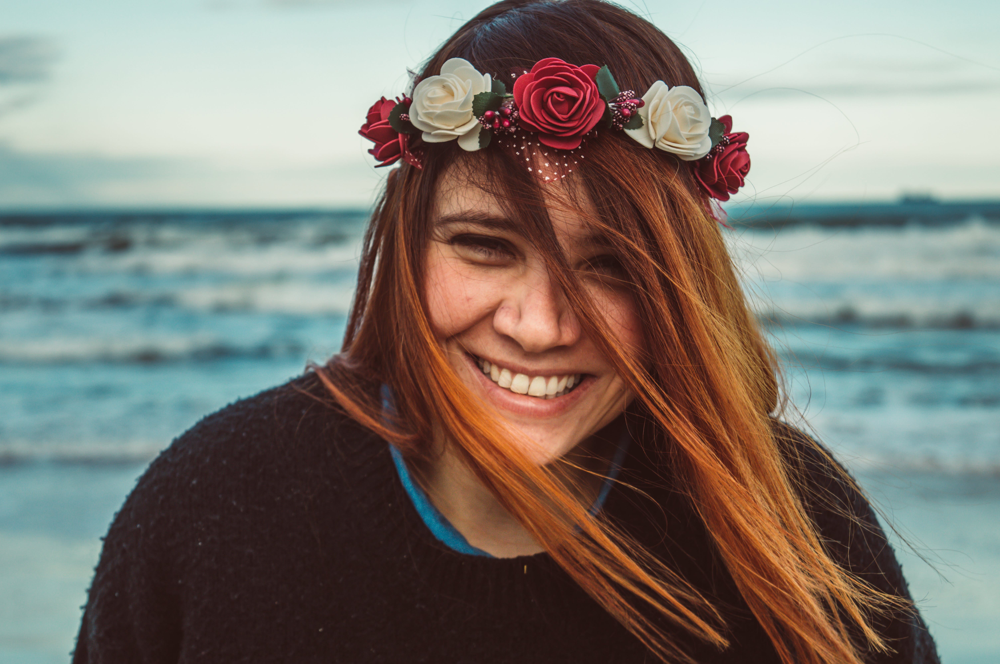

In [6]:
Image.open(stellar_data_root / "000" / "0.jpg")

## The output metadata

In [7]:
metadata = json.load((syn_path / "000-0-00.json").open("rb"))
metadata["prompt"]

'{} as a clown skiing'

## The output image

# as a clown skiing

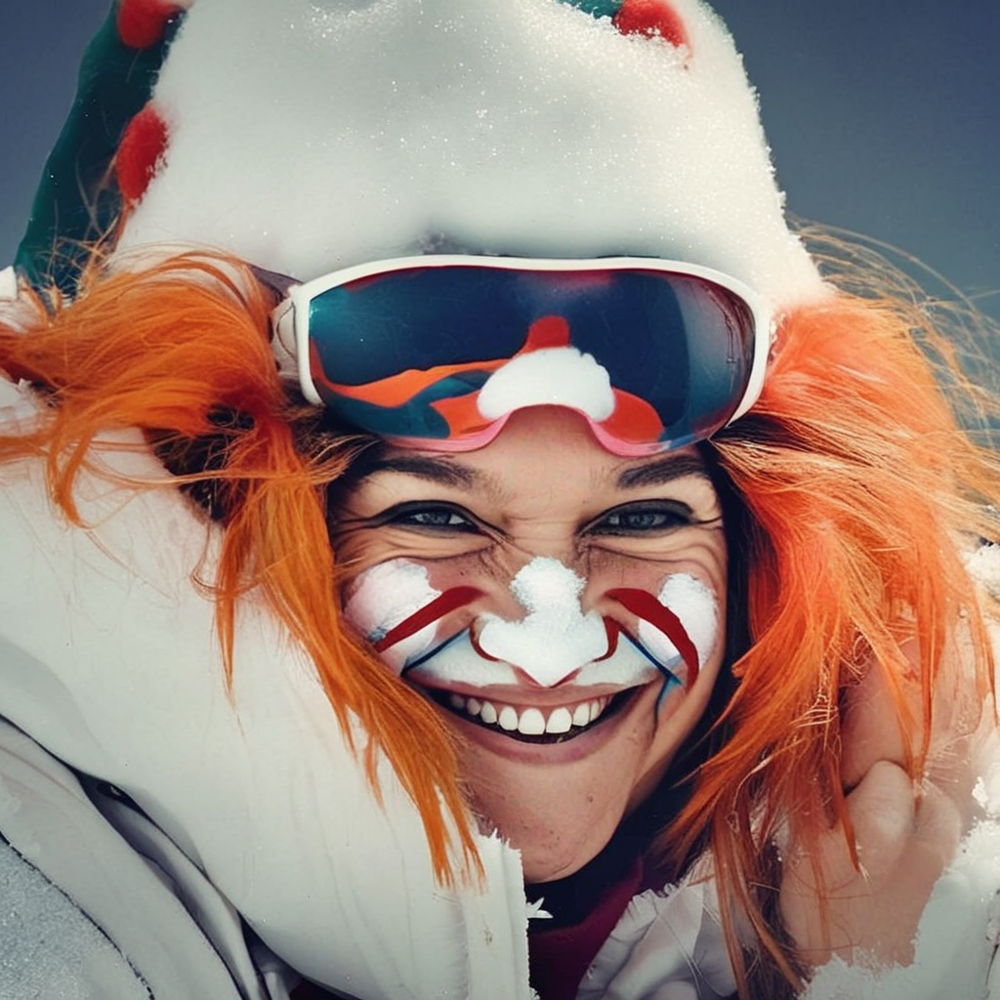

In [8]:
Image.open(syn_path / "000-0-00.png")